In [ ]:
#Copied mainly from: https://docs.opencv.org/4.x/dc/dc3/tutorial_py_matcher.html

In [ ]:
#must upload images box.png and box_in_scene.png

In [1]:
import numpy as np
import cv2 as cv2
import matplotlib.pyplot as plt

#this was created because Google Colab does not allow my_imshow, so must patch by cv2_imshow.  
#If we switch over to regular jupyter notebook not on Colab, we can change c2_imshow to my_imshow.  
from google.colab.patches import cv2_imshow #only used when running in Google Colab 
def my_imshow(title, img ):
  print(title)
  cv2_imshow(img) #should be changed to c2.imshow(img, title) when not in Colab

def myImshow(title, img):
    """
    function to make windows display work in jupyter notebook
    - shows image in a separate window,
    - waits for any key to close the window.

    """

    cv2.startWindowThread()
    my_imshow(title, img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

path = "" 
#RGB images in BGR order in penCV
img1 = cv2.imread(path+'pic1.jpg',cv2.IMREAD_GRAYSCALE)          # queryImage
# Print error message if image is null
if img1 is None:
    print('Could not read query image')
else: 
    print("Query Image read success...")

img2 = cv2.imread(path+'pic2.jpg',cv2.IMREAD_GRAYSCALE) # targetImage
# Print error message if image is null
if img2 is None:
    print('Could not read training image')
else: 
    print("Target Image read success...")

Query Image read success...
Target Image read success...


In [2]:
# Initiate SIFT detector
sift = cv2.SIFT_create()
# find the keypoints and descriptors with SIFT
#cv.KeyPoint(pt, size[, angle[, response[, octave[, class_id]]]])
kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)

print(kp1[0], '\n',des1[0], '\n Size = ', des1[0].size)

< cv2.KeyPoint 0x7fad4f7021b0> 
 [143.   6.   0.   0.   0.   0.   0.   9. 174.   2.   0.   0.   0.   0.
   0.  20. 174.   2.   0.   0.   0.   0.   0.  17.  67.   2.   0.   0.
   0.   0.   0.  10. 113.   3.   0.   0.   0.   0.   0.  10. 174.   9.
   0.   0.   0.   0.   0.  31. 174.   6.   0.   0.   0.   0.   0.  35.
  81.   2.   0.   0.   0.   0.   0.  20.  15.   0.   0.   0.   0.   0.
   0.   4. 174.  20.   0.   0.   0.   0.   0.  28. 174.  31.   0.   0.
   0.   0.   0.  38.  48.   1.   0.   0.   0.   0.   0.  46.   0.   0.
   0.   0.   0.   0.   0.   0.  24.   2.   0.   0.   0.   0.   0.   4.
 142.  21.   0.   0.   0.   0.   0.  12.  50.  13.   0.   0.   0.   0.
   2.  16.] 
 Size =  128


In [3]:
kp1[0].pt, kp1[0].size, kp1[0].angle

((2.675405740737915, 2631.305908203125), 1.9794273376464844, 39.77043151855469)

In [4]:
# BFMatcher with default params
bf = cv2.BFMatcher()
#if you use knnMatch, it will return a list of (the best) k matches instead of a single DMatch. 
#in our example k=2, so will get a list of best 2 matches per feature point
matches = bf.knnMatch(des1,des2,k=2)

print (matches)

((< cv2.DMatch 0x7fad406e76f0>, < cv2.DMatch 0x7fad406e7670>), (< cv2.DMatch 0x7fad406e7ab0>, < cv2.DMatch 0x7fad406e7b10>), (< cv2.DMatch 0x7fad406e74b0>, < cv2.DMatch 0x7fad406e7950>), (< cv2.DMatch 0x7fad406e7a90>, < cv2.DMatch 0x7fad406e7a50>), (< cv2.DMatch 0x7fad406e7850>, < cv2.DMatch 0x7fad406e7910>), (< cv2.DMatch 0x7fad406e7570>, < cv2.DMatch 0x7fad406e79d0>), (< cv2.DMatch 0x7fad406e7b30>, < cv2.DMatch 0x7fad406e7af0>), (< cv2.DMatch 0x7fad406e78f0>, < cv2.DMatch 0x7fad406e7a10>), (< cv2.DMatch 0x7fad406e7610>, < cv2.DMatch 0x7fad406e75d0>), (< cv2.DMatch 0x7fad406e7730>, < cv2.DMatch 0x7fad406e74d0>), (< cv2.DMatch 0x7fad406e7650>, < cv2.DMatch 0x7fad406e79f0>), (< cv2.DMatch 0x7fad406e7590>, < cv2.DMatch 0x7fad406e7a30>), (< cv2.DMatch 0x7fad406e7550>, < cv2.DMatch 0x7fad406e7450>), (< cv2.DMatch 0x7fad406e7ad0>, < cv2.DMatch 0x7fad406e7690>), (< cv2.DMatch 0x7fad406e74f0>, < cv2.DMatch 0x7fad406e75b0>), (< cv2.DMatch 0x7fad406e7990>, < cv2.DMatch 0x7fad406e7750>), (< cv2.

In [5]:
# Apply ratio test
good = []
for m,n in matches:
    if m.distance < 0.75*n.distance:
        good.append([m])

# cv2.drawMatchesKnn expects list of lists as matches.
#DrawMatchesFlags_DEFAULT
#DrawMatchesFlags_DRAW_OVER_OUTIMG
#DrawMatchesFlags_DRAW_RICH_KEYPOINTS
#DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
img3 = cv2.drawMatchesKnn(img1,kp1,img2,kp2,good,None,flags=cv2.DrawMatchesFlags_DRAW_RICH_KEYPOINTS)
#plt.imshow(img3),plt.show()

Original directly


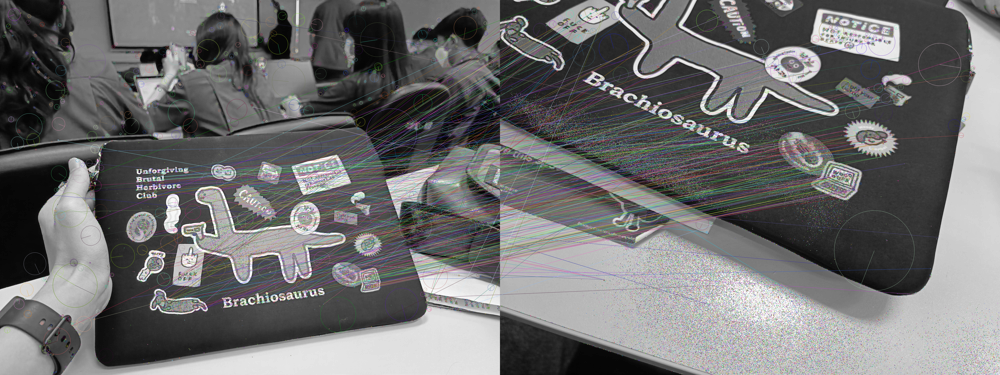

In [7]:
myImshow('Original directly', img3)

In [8]:
#writes to file
cv2.imwrite(path+'sift_match.png', img3)

True